# STRUCTURAL ANALYSIS

In [1]:
import numpy as np
import pandas as pd
import math
import scipy as sc
import matplotlib.pyplot as plt
import os
import MDAnalysis as mda
import matplotlib.ticker as ticker
from matplotlib import axes
import sys
np.set_printoptions(threshold=sys.maxsize)

from MDAnalysis.analysis import rms, align, diffusionmap
from MDAnalysis.lib import distances
from MDAnalysis.analysis.align import AlignTraj
from MDAnalysis.analysis.rms import RMSF

from matplotlib.colors import ListedColormap, LinearSegmentedColormap
    


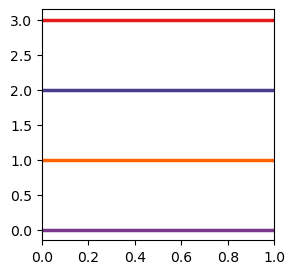

In [2]:
# color identification of protein parts
# colors : [  chain1,    chain2,      as1,      as2    ]
new_cmap = [ '#7A378B', '#FF6103', '#483D8B' ,'#E31A1C' ]
rtg_r = LinearSegmentedColormap.from_list("rtg", new_cmap)
colors2 = rtg_r(np.linspace(0,1,4))

#Test colormap
fig = plt.figure(figsize=(3,3))

for i,color in enumerate(colors2):
    plt.axhline(i, color=colors2[i], linewidth=2.5)
    



In [3]:
datadir = os.getcwd()
datadir

'/Volumes/TERESA-HDD/CBP_project/mutant_8D4J'

### Selections

In [9]:
data3 = datadir+'/3rd_simulation_600ns'
data4 = datadir+'/4th_simulation_600ns'
data5 = datadir+'/5th_simulation_600ns'

data_7vh8 = datadir+'/../WT_7VH8/'
data_6xhu = datadir+'/../WT_6XHU/'

#import data for the universe - same npt file for all 3 simulations
GRO_8D4J = data3+'/3_NPT/npt.gro'
GRO_7VH8 = data_7vh8+'/5_NPT/npt.gro'
GRO_6XHU = data_6xhu+'/3_NPT/npt.gro'

# aligned universe not equilibrated
al_8d4j_3 = mda.Universe(GRO_8D4J, str(data3+'/4_run/aligned_traj.xtc'))
al_8d4j_4 = mda.Universe(GRO_8D4J, str(data4+'/4_run/aligned_traj.xtc'))
al_8d4j_5 = mda.Universe(GRO_8D4J, str(data5+'/4_run/aligned_traj.xtc'))
al_7vh8 = mda.Universe(GRO_7VH8, str(data_7vh8+'/6_run/aligned_traj.xtc'))
al_6xhu = mda.Universe(GRO_6XHU, str(data_6xhu+'/4_run/aligned_traj.xtc'))

# aligned universe equilibrated
al_8d4j_3_eq = mda.Universe(GRO_8D4J, str(data3+'/4_run/aligned_traj_eq.xtc'))
al_8d4j_4_eq = mda.Universe(GRO_8D4J, str(data4+'/4_run/aligned_traj_eq.xtc'))
al_8d4j_5_eq = mda.Universe(GRO_8D4J, str(data5+'/4_run/aligned_traj_eq.xtc'))
al_7vh8_eq = mda.Universe(GRO_7VH8, str(data_7vh8+'/6_run/aligned_traj_eq.xtc'))
al_6xhu_eq = mda.Universe(GRO_6XHU, str(data_6xhu+'/4_run/aligned_traj_eq.xtc'))

/opt/anaconda3/envs/QCB/lib/python3.8/site-packages/MDAnalysis/coordinates/XDR.py:196: UserWarning: Reload offsets from trajectory
 ctime or size or n_atoms did not match
  warnings.warn("Reload offsets from trajectory\n "


# 1. Pair RMSD - to determine cut

In [5]:
import seaborn as sns

## Mutant 8D4J

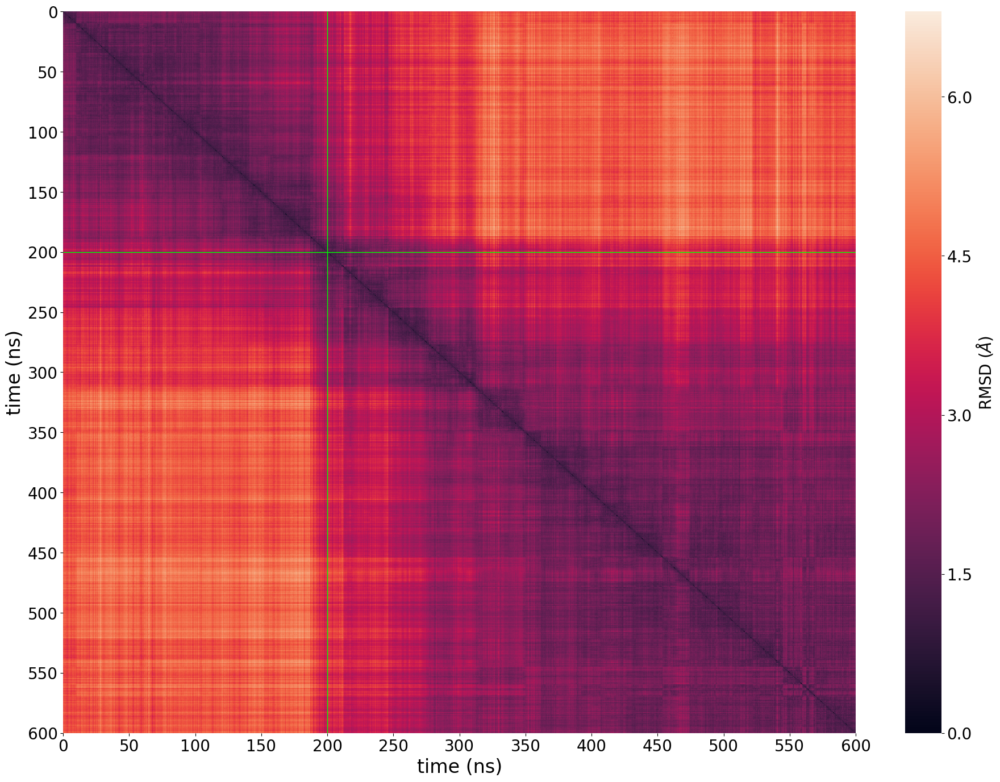

In [31]:
PAIR_RMSD_HALF_3 = data3+'/4_run/data/pair_rmsd/pair_rmsd_ca.dat'


df = pd.read_csv(PAIR_RMSD_HALF_3, sep='\s+', header=None, usecols = [0,1,2], names = ['traj1', 'traj2', 'RMSD'])

df

# convert df in matrix
matrix = np.array(df)

# generate a matrix of dimension 8002 x 8002 of zeros and fill the tridiagonal inferior part with data in 
# the matrix above

#-------
# change l and matrix dimension depending on the length of the simulation
#-------

rmsd_mat_half = np.zeros((12002,12002))
l = 72030003 # range(0,3) = 0,1,2
for i in range(0,l):
    rmsd_mat_half[int(matrix[i,0]),int(matrix[i,1])] = matrix[i,2]
    
# copy the tridiagonal inferior part of the matrix with respect to the diagonal
for i in range(0,12002):
    for j in range(0,i):
        rmsd_mat_half[j,i] = rmsd_mat_half[i,j]
        
# Define the plot
fig, ax = plt.subplots(figsize=(22.5,16.5))

#plt.title('Pairwise RMSD 8D4J - simulation 1',fontsize=18)
ttl = ax.title
ttl.set_position([0.5,1.05])

sns.heatmap(rmsd_mat_half, lw = 0, xticklabels=1000, yticklabels=1000)

plt.yticks(rotation=0) 
ax.hlines([4000], *ax.get_xlim(), lw = 1, color = '#00FF00')
ax.vlines([4000], *ax.get_ylim(), lw = 1, color = '#00FF00')
ax.set(xlabel='time (ns)', ylabel='time (ns)')

ticks = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x*0.05-0.025))
ax.xaxis.set_major_formatter(ticks)
ax.yaxis.set_major_formatter(ticks)
ax.tick_params(labelsize=20)

cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=20)
cbar.set_label('RMSD ($\AA$)',fontsize = 20)

plt.show()

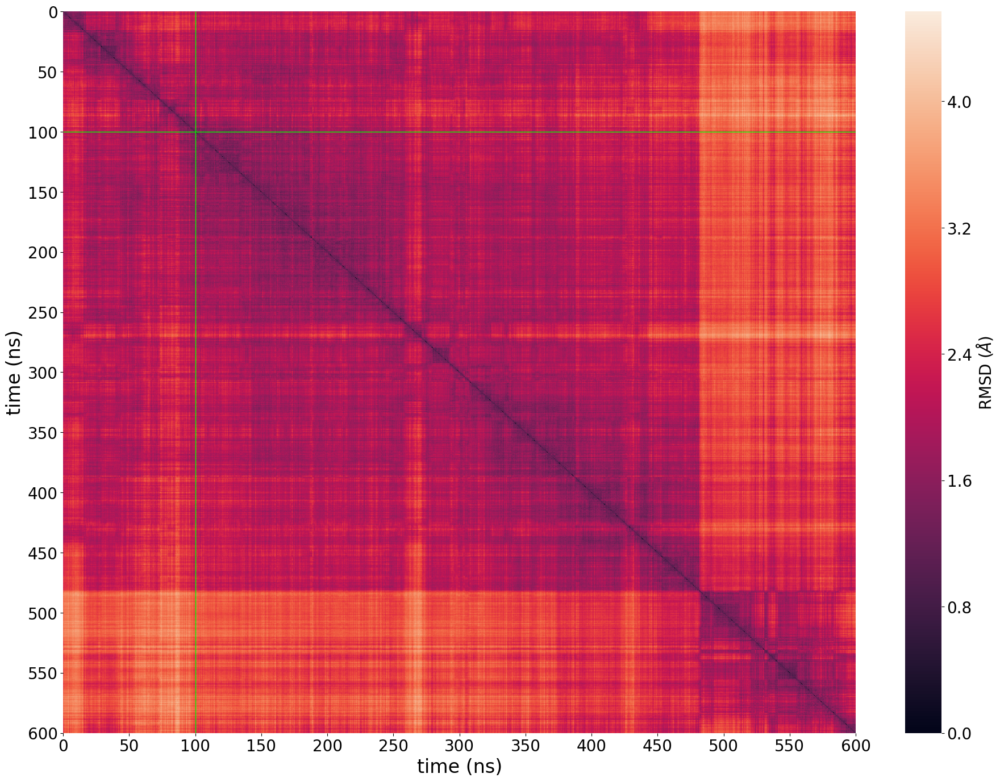

In [34]:
PAIR_RMSD_HALF_4 = data4+'/4_run/data/pair_rmsd/pair_rmsd_ca.dat'


df = pd.read_csv(PAIR_RMSD_HALF_4, sep='\s+', header=None, usecols = [0,1,2], names = ['traj1', 'traj2', 'RMSD'])

df

# convert df in matrix
matrix = np.array(df)

# generate a matrix of dimension 8002 x 8002 of zeros and fill the tridiagonal inferior part with data in 
# the matrix above

#-------
# change l and matrix dimension depending on the length of the simulation
#-------

rmsd_mat_half = np.zeros((12002,12002))
l = 72030003 # range(0,3) = 0,1,2
for i in range(0,l):
    rmsd_mat_half[int(matrix[i,0]),int(matrix[i,1])] = matrix[i,2]
    
# copy the tridiagonal inferior part of the matrix with respect to the diagonal
for i in range(0,12002):
    for j in range(0,i):
        rmsd_mat_half[j,i] = rmsd_mat_half[i,j]
        


# Define the plot
fig, ax = plt.subplots(figsize=(22.5,16.5))

#plt.title('Pairwise RMSD 8D4J - simulation 2',fontsize=18)
ttl = ax.title
ttl.set_position([0.5,1.05])

sns.heatmap(rmsd_mat_half, lw = 0, xticklabels=1000, yticklabels=1000)

plt.xlabel('time (ns)',fontsize=24)
plt.ylabel('time (ns)',fontsize=24)
plt.yticks(rotation=0) 
ax.hlines([2000], *ax.get_xlim(), lw = 1, color = '#00FF00')
ax.vlines([2000], *ax.get_ylim(), lw = 1, color = '#00FF00')
ax.set(xlabel='time (ns)', ylabel='time (ns)')

ticks = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x*0.05-0.025))
ax.xaxis.set_major_formatter(ticks)
ax.yaxis.set_major_formatter(ticks)
ax.tick_params(labelsize=20)

cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=20)
cbar.set_label('RMSD ($\AA$)',fontsize = 20)
plt.show()

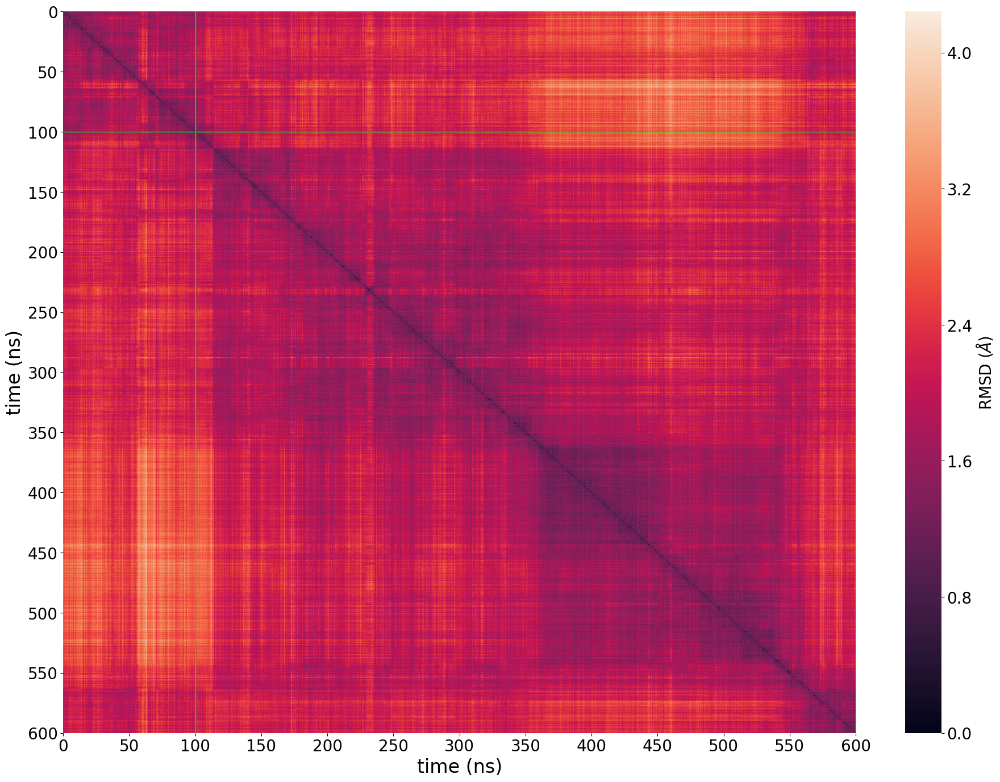

In [35]:
PAIR_RMSD_HALF_5 = data5+'/4_run/data/pair_rmsd/pair_rmsd_ca.dat'


df = pd.read_csv(PAIR_RMSD_HALF_5, sep='\s+', header=None, usecols = [0,1,2], names = ['traj1', 'traj2', 'RMSD'])

df

# convert df in matrix
matrix = np.array(df)

# generate a matrix of dimension 8002 x 8002 of zeros and fill the tridiagonal inferior part with data in 
# the matrix above

#-------
# change l and matrix dimension depending on the length of the simulation
#-------

rmsd_mat_half = np.zeros((12002,12002))
l = 72030003 # range(0,3) = 0,1,2
for i in range(0,l):
    rmsd_mat_half[int(matrix[i,0]),int(matrix[i,1])] = matrix[i,2]
    
# copy the tridiagonal inferior part of the matrix with respect to the diagonal
for i in range(0,12002):
    for j in range(0,i):
        rmsd_mat_half[j,i] = rmsd_mat_half[i,j]
        
 # Define the plot
fig, ax = plt.subplots(figsize=(22.5,16.5))

sns.heatmap(rmsd_mat_half, lw = 0, xticklabels=1000, yticklabels=1000)

plt.xlabel('time (ns)',fontsize=24)
plt.ylabel('time (ns)',fontsize=24)

plt.yticks(rotation=0) 
ax.hlines([2000], *ax.get_xlim(), lw = 1, color = '#00FF00')
ax.vlines([2000], *ax.get_ylim(), lw = 1, color = '#00FF00')
ax.set(xlabel='time (ns)', ylabel='time (ns)')

ticks = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x*0.05-0.025))
ax.xaxis.set_major_formatter(ticks)
ax.yaxis.set_major_formatter(ticks)
ax.tick_params(labelsize=20)

cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=20)
cbar.set_label('RMSD ($\AA$)',fontsize = 20)
plt.show()

## Wild type 7VH8

In [ ]:
PAIR_RMSD_7VH8 = data_7vh8+'6_run/data/pair_rmsd/pair_rmsd_ca.dat'


df = pd.read_csv(PAIR_RMSD_7VH8, sep='\s+', header=None, usecols = [0,1,2], names = ['traj1', 'traj2', 'RMSD'])

df

# convert df in matrix
matrix = np.array(df)

# generate a matrix of dimension 8002 x 8002 of zeros and fill the tridiagonal inferior part with data in 
# the matrix above

#-------
# change l and matrix dimension depending on the length of the simulation
#-------

rmsd_mat_half = np.zeros((12002,12002))
l = 72030003 # range(0,3) = 0,1,2
for i in range(0,l):
    rmsd_mat_half[int(matrix[i,0]),int(matrix[i,1])] = matrix[i,2]
    
# copy the tridiagonal inferior part of the matrix with respect to the diagonal
for i in range(0,12002):
    for j in range(0,i):
        rmsd_mat_half[j,i] = rmsd_mat_half[i,j]
        

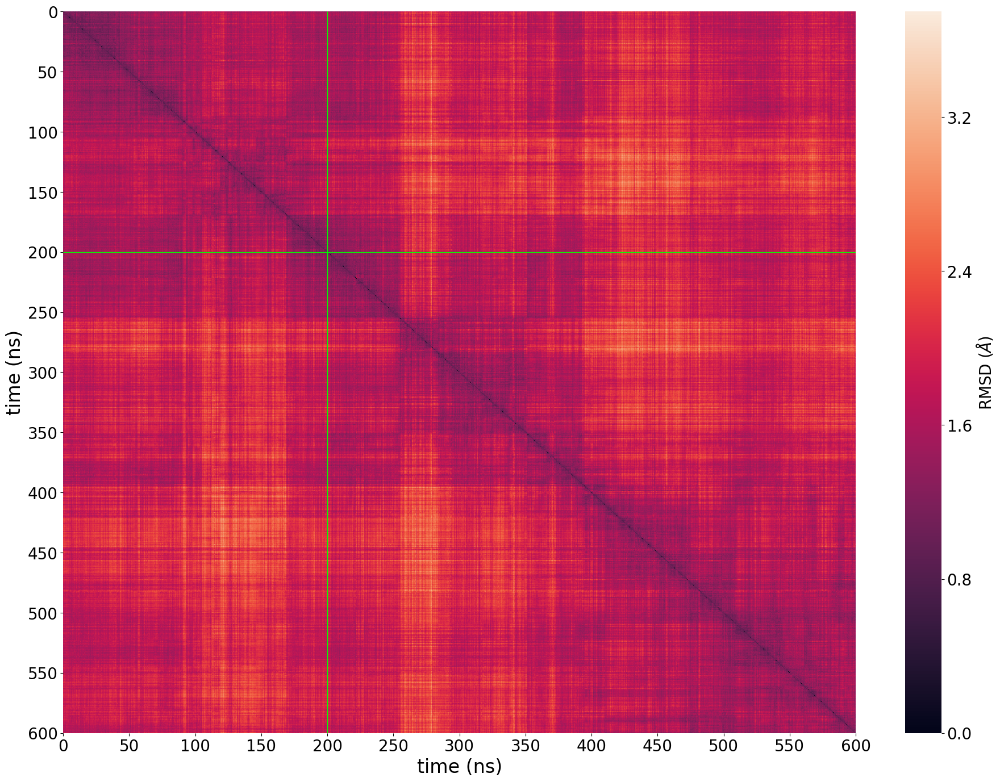

In [13]:
 # Define the plot
fig, ax = plt.subplots(figsize=(22.5,16.5))

sns.heatmap(rmsd_mat_half, lw = 0, xticklabels=1000, yticklabels=1000)

plt.xlabel('time (ns)',fontsize=24)
plt.ylabel('time (ns)',fontsize=24)

plt.yticks(rotation=0) 
ax.hlines([4000], *ax.get_xlim(), lw = 1, color = '#00FF00')
ax.vlines([4000], *ax.get_ylim(), lw = 1, color = '#00FF00')
ax.set(xlabel='time (ns)', ylabel='time (ns)')

ticks = ticker.FuncFormatter(lambda x, pos: '{0:g}'.format(x*0.05-0.025))
ax.xaxis.set_major_formatter(ticks)
ax.yaxis.set_major_formatter(ticks)
ax.tick_params(labelsize=20)

cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=20)
cbar.set_label('RMSD ($\AA$)',fontsize = 20)
plt.show()

# 2. RMSD equilibrated

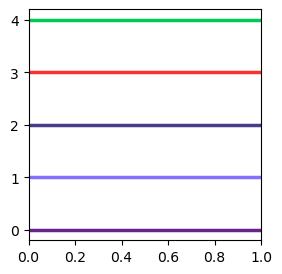

In [6]:
# color selection

# colors = [ 8d4j_1,    8d4j_2,    8d4j_3,    7vh8,    6xhu] 
new_cmap = ['#68228B','#8470FF','#483D8B', '#FF3030', '#00C957' ]
rtg_r = LinearSegmentedColormap.from_list("rtg", new_cmap)
colors = rtg_r(np.linspace(0,1,5))

#Test colormap
fig = plt.figure(figsize=(3,3))

for i,color in enumerate(colors):
    plt.axhline(i, color=colors[i], linewidth=2.5)

In [10]:
# full protein with CA selection
RMSD_CA_3_EQ = data3+'/4_run/data/rmsd/rmsd_ca_eq.dat'
RMSD_CA_4_EQ = data4+'/4_run/data/rmsd/rmsd_ca_eq.dat'
RMSD_CA_5_EQ = data5+'/4_run/data/rmsd/rmsd_ca_eq.dat'
RMSD_CA_7VH8_EQ = data_7vh8+'/6_run/data/rmsd/rmsd_ca_eq.dat'
RMSD_CA_6XHU_EQ = data_6xhu+'/4_run/data/rmsd/rmsd_ca_eq.dat'


rmsd_ca_3_eq = pd.read_csv(RMSD_CA_3_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ca_4_eq = pd.read_csv(RMSD_CA_4_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ca_5_eq = pd.read_csv(RMSD_CA_5_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ca_7vh8_eq = pd.read_csv(RMSD_CA_7VH8_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ca_6xhu_eq = pd.read_csv(RMSD_CA_6XHU_EQ, sep='\s+', header=None,usecols = [0,1,2])



avg_3 = rmsd_ca_3_eq[2000:][2].mean()
avg_4 = rmsd_ca_4_eq[2000:8000][2].mean()
avg_5 = rmsd_ca_5_eq[2000:8000][2].mean()
avg_7vh8 = rmsd_ca_7vh8_eq[2000:][2].mean()
print(avg_3, avg_4, avg_5, avg_7vh8)

3.499738709596428 2.0658068673634165 2.2974917164082957 1.8224250911384656


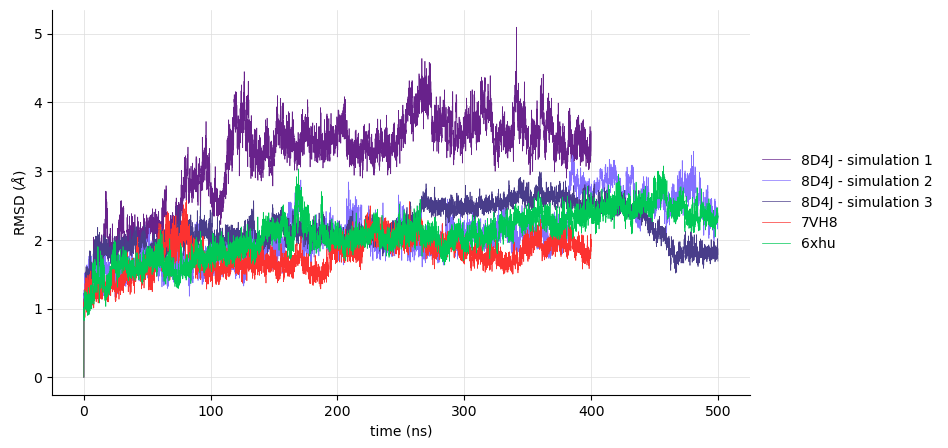

In [11]:
r3_eq = rmsd_ca_3_eq[2]
r4_eq = rmsd_ca_4_eq[2]
r5_eq = rmsd_ca_5_eq[2]
r7vh8_eq = rmsd_ca_7vh8_eq[2]
r6xhu_eq = rmsd_ca_6xhu_eq[2]

time3 = rmsd_ca_3_eq[1]/1e3
time3 = time3 - time3[0]
time4 = rmsd_ca_4_eq[1]/1e3
time4 = time4 - time4[0]
time5 = rmsd_ca_5_eq[1]/1e3
time5 = time5 - time5[0]
time7vh8 = rmsd_ca_7vh8_eq[1]/1e3
time7vh8 = time7vh8 - time7vh8[0]
time6xhu = rmsd_ca_6xhu_eq[1]/1e3
time6xhu = time6xhu - time6xhu[0]


f = plt.figure(figsize=(9,5))
ax = plt.subplot(111)

ax.plot(time3, r3_eq, color = colors[0], lw=0.5 , label = "8D4J - simulation 1" )
ax.plot(time4, r4_eq, color = colors[1], lw=0.5 , label = "8D4J - simulation 2" )
ax.plot(time5, r5_eq, color = colors[2], lw=0.5 , label = "8D4J - simulation 3" )
ax.plot(time7vh8, r7vh8_eq, color = colors[3], lw=0.5 , label = "7VH8" )
ax.plot(time6xhu, r6xhu_eq, color = colors[4], lw=0.5 , label = "6xhu" )

ax.legend(loc="best")
leg = ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

ax.grid(color = '#DCDCDC', lw = 0.5)

#ax.set_title("Full protein - CA selection")

ax.set_xlabel("time (ns)")
ax.set_ylabel(r"RMSD ($\AA$)")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


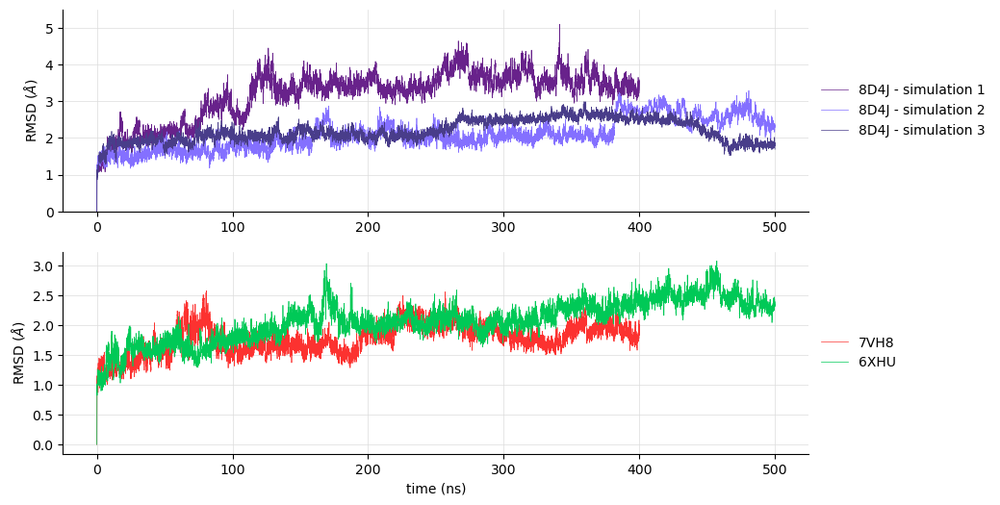

In [14]:
r3_eq = rmsd_ca_3_eq[2]
r4_eq = rmsd_ca_4_eq[2]
r5_eq = rmsd_ca_5_eq[2]
r7vh8_eq = rmsd_ca_7vh8_eq[2]

time3 = rmsd_ca_3_eq[1]/1e3
time3 = time3 - time3[0]
time4 = rmsd_ca_4_eq[1]/1e3
time4 = time4 - time4[0]
time5 = rmsd_ca_5_eq[1]/1e3
time5 = time5 - time5[0]
time7vh8 = rmsd_ca_7vh8_eq[1]/1e3
time7vh8 = time7vh8 - time7vh8[0]

f = plt.figure(figsize=(10,6))
# RMSD - mutant
ax1 = f.add_subplot(211)
ax1.plot(time3, r3_eq, color = colors[0], lw=0.5 , label = "8D4J - simulation 1" )
ax1.plot(time4, r4_eq, color = colors[1], lw=0.5 , label = "8D4J - simulation 2" )
ax1.plot(time5, r5_eq, color = colors[2], lw=0.5 , label = "8D4J - simulation 3" )

leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSD ($\AA$)")
ax1.set_ylim([0,5.5])

# RMSD wt
ax2 = f.add_subplot(212)
ax2.plot(time7vh8, r7vh8_eq, color = colors[3], lw=0.5 , label = "7VH8" )
ax2.plot(time6xhu, r6xhu_eq, color = colors[4], lw=0.5 , label = "6XHU" )
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("time (ns)")
ax2.set_ylabel("RMSD ($\AA$)")


ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

#ax1.set_title('8D4J - simulation 1')

### RMSD chain 1 and 2 of first simulation 8D4J

In [9]:
RMSD_CH1_3_EQ = data3+'/4_run/data/rmsd/rmsd_ch1_eq.dat'
RMSD_CH2_3_EQ = data3+'/4_run/data/rmsd/rmsd_ch2_eq.dat'
RMSD_CH1_4_EQ = data4+'/4_run/data/rmsd/rmsd_ch1_eq.dat'
RMSD_CH2_4_EQ = data4+'/4_run/data/rmsd/rmsd_ch2_eq.dat'
RMSD_CH1_5_EQ = data5+'/4_run/data/rmsd/rmsd_ch1_eq.dat'
RMSD_CH2_5_EQ = data5+'/4_run/data/rmsd/rmsd_ch2_eq.dat'
RMSD_CH1_7VH8_EQ = data_7vh8+'/6_run/data/rmsd/rmsd_ch1_eq.dat'
RMSD_CH2_7VH8_EQ = data_7vh8+'/6_run/data/rmsd/rmsd_ch2_eq.dat'


rmsd_ch1_3_eq = pd.read_csv(RMSD_CH1_3_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch2_3_eq = pd.read_csv(RMSD_CH2_3_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch1_4_eq = pd.read_csv(RMSD_CH1_4_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch2_4_eq = pd.read_csv(RMSD_CH2_4_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch1_5_eq = pd.read_csv(RMSD_CH1_5_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch2_5_eq = pd.read_csv(RMSD_CH2_5_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch1_7vh8_eq = pd.read_csv(RMSD_CH1_7VH8_EQ, sep='\s+', header=None,usecols = [0,1,2])
rmsd_ch2_7vh8_eq = pd.read_csv(RMSD_CH2_7VH8_EQ, sep='\s+', header=None,usecols = [0,1,2])

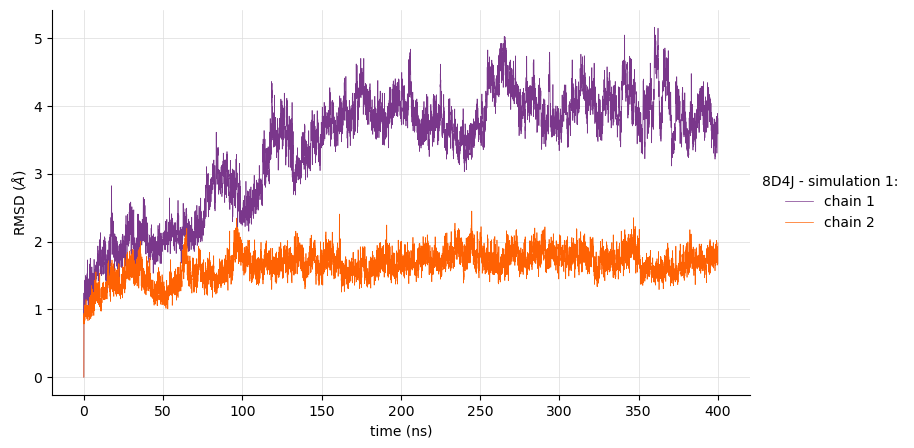

In [159]:
r3_ch1_eq = rmsd_ch1_3_eq[2]
r3_ch2_eq = rmsd_ch2_3_eq[2]

time3 = rmsd_ch1_3_eq[1]/1e3
time3 = time3 - time3[0]


f = plt.figure(figsize=(9,5))
ax = plt.subplot(111)

ax.plot(time3, r3_ch1_eq, color = colors2[0], lw=0.5 , label = "chain 1" )
ax.plot(time3, r3_ch2_eq, color = colors2[1], lw=0.5 , label = "chain 2" )


ax.legend(loc="best")
leg = ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), title = '8D4J - simulation 1:')
leg.get_frame().set_linewidth(0.0)

ax.grid(color = '#DCDCDC', lw = 0.5)

#ax.set_title("Full protein - CA selection")

ax.set_xlabel("time (ns)")
ax.set_ylabel(r"RMSD ($\AA$)")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# 3. Radius of gyration equilibrated

In [15]:
Rgyr_3_ca_eq = np.load(data3+'/4_run/data/rg/Rgyr_ca_eq.npy')
Rgyr_4_ca_eq = np.load(data4+'/4_run/data/rg/Rgyr_ca_eq.npy')
Rgyr_5_ca_eq = np.load(data5+'/4_run/data/rg/Rgyr_ca_eq.npy')
Rgyr_7vh8_eq = np.load(data_7vh8+'/6_run/data/rg/Rgyr_ca_eq.npy')
Rgyr_6xhu_eq = np.load(data_6xhu+'/4_run/data/rg/Rgyr_ca_eq.npy')



avg_3 = np.mean(Rgyr_3_ca_eq[:,1])
avg_4 = np.mean(Rgyr_4_ca_eq[:,1])
avg_5 = np.mean(Rgyr_5_ca_eq[:,1])
avg_7vh8 = np.mean(Rgyr_7vh8_eq[:,1])
print(avg_3, avg_4, avg_5, avg_7vh8)

25.928878698967935 25.717307612451176 25.626696996876106 25.420974924478582


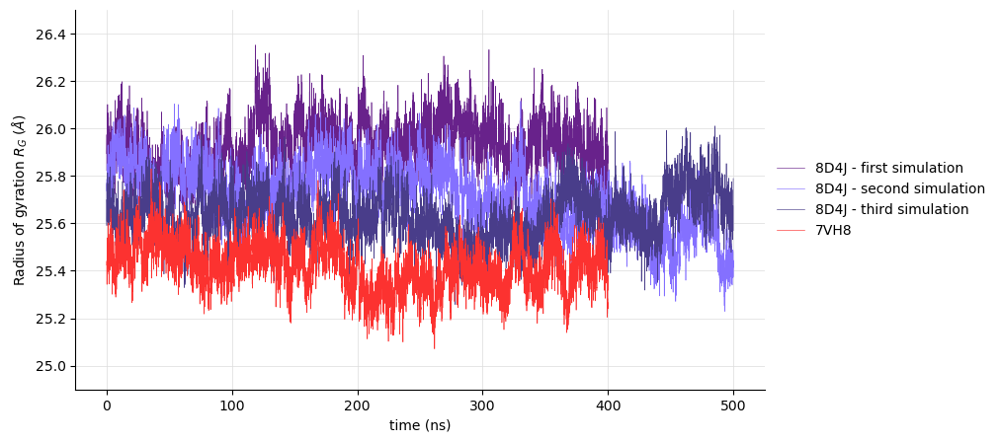

In [150]:
time3 = Rgyr_3_ca_eq[:,0]/1e3
time3 = time3 - time3[0]
time4 = Rgyr_4_ca_eq[:,0]/1e3
time4 = time4 - time4[0]
time5 = Rgyr_5_ca_eq[:,0]/1e3
time5 = time5 - time5[0]
time7vh8 = Rgyr_7vh8_eq[:,0]/1e3
time7vh8 = time7vh8 - time7vh8[0]

f = plt.figure(figsize=(9,5))
ax = plt.subplot(111)

ax.plot(time3, Rgyr_3_ca_eq[:,1], color = colors[0], lw=0.45, label = '8D4J - first simulation')
ax.plot(time4, Rgyr_4_ca_eq[:,1], color = colors[1], lw=0.45, label = '8D4J - second simulation')
ax.plot(time5, Rgyr_5_ca_eq[:,1], color = colors[2], lw=0.45, label = '8D4J - third simulation')
ax.plot(time7vh8, Rgyr_7vh8_eq[:,1], color = colors[3], lw=0.45, label = '7VH8')
ax.set_xlabel("time (ns)")
ax.set_ylabel("Radius of gyration $R_G$ ($\AA$)") 

ax.legend(loc="best")
leg = ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

ax.grid(color = '#DCDCDC', lw = 0.5)
ax.set_ylim([24.9,26.5])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

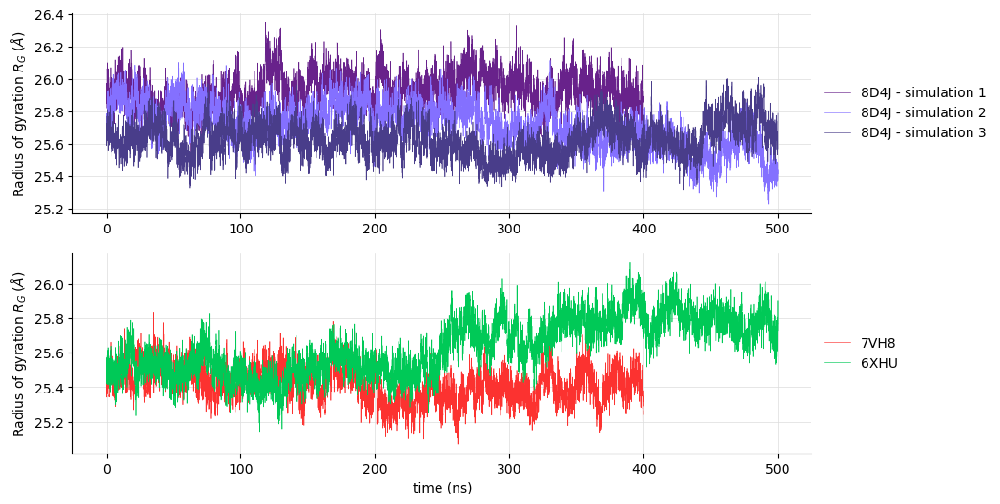

In [19]:
time3 = Rgyr_3_ca_eq[:,0]/1e3
time3 = time3 - time3[0]
time4 = Rgyr_4_ca_eq[:,0]/1e3
time4 = time4 - time4[0]
time5 = Rgyr_5_ca_eq[:,0]/1e3
time5 = time5 - time5[0]
time7vh8 = Rgyr_7vh8_eq[:,0]/1e3
time7vh8 = time7vh8 - time7vh8[0]
time6xhu = Rgyr_6xhu_eq[:,0]/1e3
time6xhu = time6xhu - time6xhu[0]

f = plt.figure(figsize=(10,6))
# Rg - mutant
ax1 = f.add_subplot(211)
ax1.plot(time3, Rgyr_3_ca_eq[:,1], color = colors[0], lw=0.45, label = '8D4J - simulation 1')
ax1.plot(time4, Rgyr_4_ca_eq[:,1], color = colors[1], lw=0.45, label = '8D4J - simulation 2')
ax1.plot(time5, Rgyr_5_ca_eq[:,1], color = colors[2], lw=0.45, label = '8D4J - simulation 3')

leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel("Radius of gyration $R_G$ ($\AA$)") 


# Rg wt
ax2 = f.add_subplot(212)
ax2.plot(time7vh8, Rgyr_7vh8_eq[:,1], color = colors[3], lw=0.45, label = '7VH8')
ax2.plot(time6xhu, Rgyr_6xhu_eq[:,1], color = colors[4], lw=0.45, label = '6XHU')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("time (ns)")
ax2.set_ylabel("Radius of gyration $R_G$ ($\AA$)") 


ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

### Radius of gyration of chain 1 and 2 separately

In [11]:
Rgyr_3_ch1_eq = np.load(data3+'/4_run/data/rg/Rgyr_ch1_eq.npy')
Rgyr_3_ch2_eq = np.load(data3+'/4_run/data/rg/Rgyr_ch2_eq.npy')
Rgyr_4_ch1_eq = np.load(data4+'/4_run/data/rg/Rgyr_ch1_eq.npy')
Rgyr_4_ch2_eq = np.load(data4+'/4_run/data/rg/Rgyr_ch2_eq.npy')
Rgyr_5_ch1_eq = np.load(data5+'/4_run/data/rg/Rgyr_ch1_eq.npy')
Rgyr_5_ch2_eq = np.load(data5+'/4_run/data/rg/Rgyr_ch2_eq.npy')
Rgyr_7vh8_ch1_eq = np.load(data_7vh8+'/6_run/data/rg/Rgyr_ch1_eq.npy')
Rgyr_7vh8_ch2_eq = np.load(data_7vh8+'/6_run/data/rg/Rgyr_ch2_eq.npy')


### Combined plots : RMSD and Rg

Text(0.5, 1.0, '8D4J - simulation 1')

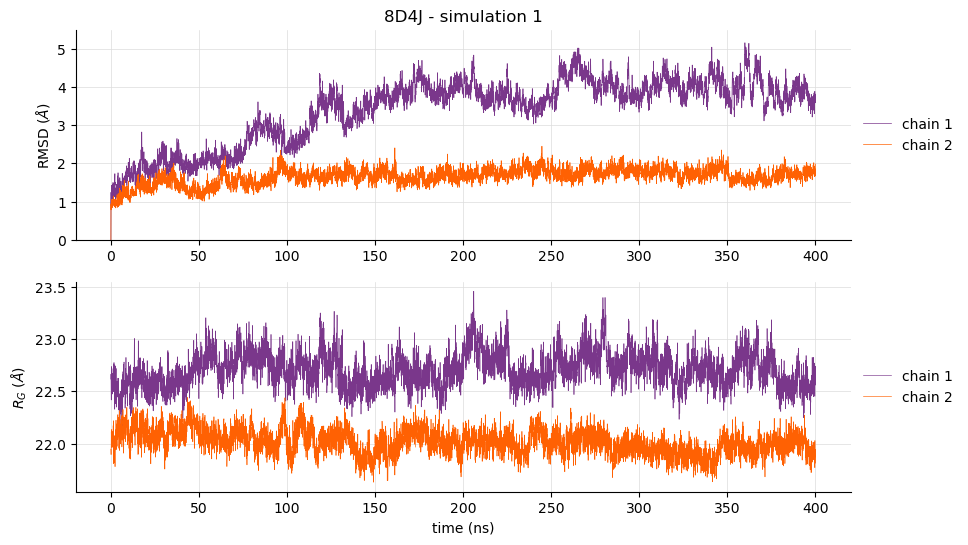

In [168]:
r3_ch1_eq = rmsd_ch1_3_eq[2]
r3_ch2_eq = rmsd_ch2_3_eq[2]

time3 = rmsd_ch1_3_eq[1]/1e3
time3 = time3 - time3[0]

f = plt.figure(figsize=(10,6))
# RMSD - chain 1 and 2
ax1 = f.add_subplot(211)
ax1.plot(time3, r3_ch1_eq, color = colors2[0], lw=0.5 , label = 'chain 1' )
ax1.plot(time3, r3_ch2_eq, color = colors2[1], lw=0.5 , label = 'chain 2' )
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSD ($\AA$)")
ax1.set_ylim([0,5.5])

# Radius of gyration - chain 1 and 2
ax2 = f.add_subplot(212)
ax2.plot(time3, Rgyr_3_ch1_eq[:,1], color = colors2[0], lw=0.45, label = 'chain 1')
ax2.plot(time3, Rgyr_3_ch2_eq[:,1], color = colors2[1], lw=0.45, label = 'chain 2')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("time (ns)")
ax2.set_ylabel("$R_G$ ($\AA$)")


ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

ax1.set_title('8D4J - simulation 1')

Text(0.5, 1.0, '8D4J - simulation 2')

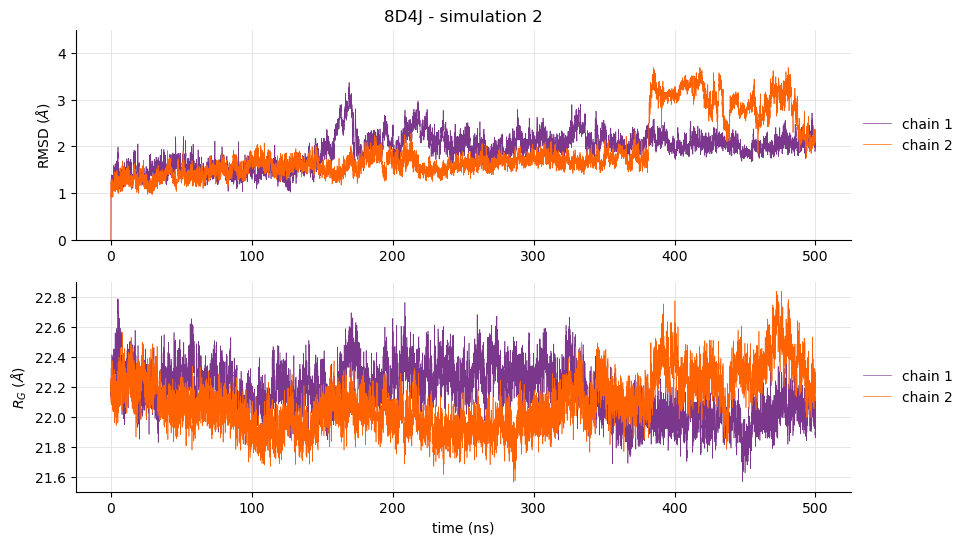

In [186]:
r4_ch1_eq = rmsd_ch1_4_eq[2]
r4_ch2_eq = rmsd_ch2_4_eq[2]

time4 = rmsd_ch1_4_eq[1]/1e3
time4 = time4 - time4[0]

f = plt.figure(figsize=(10,6))
# RMSD - chain 1 and 2
ax1 = f.add_subplot(211)
ax1.plot(time4, r4_ch1_eq, color = colors2[0], lw=0.5 , label = 'chain 1' )
ax1.plot(time4, r4_ch2_eq, color = colors2[1], lw=0.5 , label = 'chain 2' )
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSD ($\AA$)")
ax1.set_ylim([0,4.5])

# Radius of gyration - chain 1 and 2
ax2 = f.add_subplot(212)
ax2.plot(time4, Rgyr_4_ch1_eq[:,1], color = colors2[0], lw=0.45, label = 'chain 1')
ax2.plot(time4, Rgyr_4_ch2_eq[:,1], color = colors2[1], lw=0.45, label = 'chain 2')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("time (ns)")
ax2.set_ylabel("$R_G$ ($\AA$)")


ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

ax1.set_title('8D4J - simulation 2')

Text(0.5, 1.0, '8D4J - simulation 3')

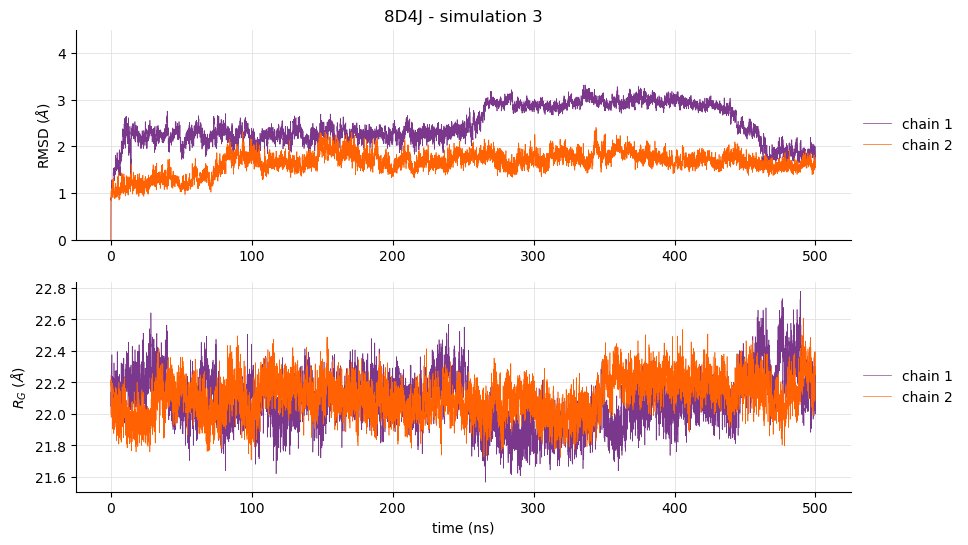

In [187]:
r5_ch1_eq = rmsd_ch1_5_eq[2]
r5_ch2_eq = rmsd_ch2_5_eq[2]

time5 = rmsd_ch1_5_eq[1]/1e3
time5 = time5 - time5[0]

f = plt.figure(figsize=(10,6))
# RMSD - chain 1 and 2
ax1 = f.add_subplot(211)
ax1.plot(time5, r5_ch1_eq, color = colors2[0], lw=0.5 , label = 'chain 1' )
ax1.plot(time5, r5_ch2_eq, color = colors2[1], lw=0.5 , label = 'chain 2' )
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSD ($\AA$)")
ax1.set_ylim([0,4.5])

# Radius of gyration - chain 1 and 2
ax2 = f.add_subplot(212)
ax2.plot(time5, Rgyr_5_ch1_eq[:,1], color = colors2[0], lw=0.45, label = 'chain 1')
ax2.plot(time5, Rgyr_5_ch2_eq[:,1], color = colors2[1], lw=0.45, label = 'chain 2')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("time (ns)")
ax2.set_ylabel("$R_G$ ($\AA$)")


ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

ax1.set_title('8D4J - simulation 3')

Text(0.5, 1.0, '7VH8')

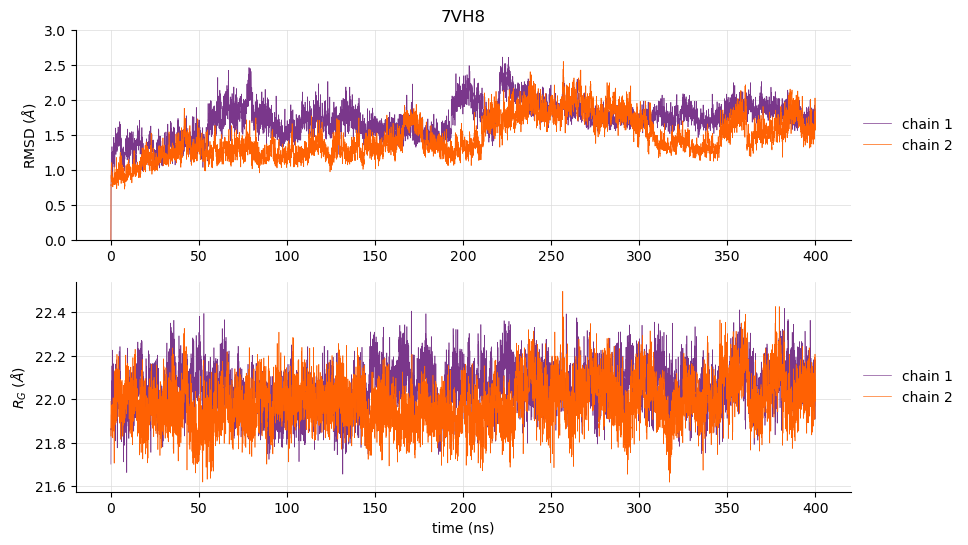

In [193]:
r7vh8_ch1_eq = rmsd_ch1_7vh8_eq[2]
r7vh8_ch2_eq = rmsd_ch2_7vh8_eq[2]

time7vh8 = rmsd_ch1_7vh8_eq[1]/1e3
time7vh8 = time7vh8 - time7vh8[0]

f = plt.figure(figsize=(10,6))
# RMSD - chain 1 and 2
ax1 = f.add_subplot(211)
ax1.plot(time7vh8, r7vh8_ch1_eq, color = colors2[0], lw=0.5 , label = 'chain 1' )
ax1.plot(time7vh8, r7vh8_ch2_eq, color = colors2[1], lw=0.5 , label = 'chain 2' )
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSD ($\AA$)")
ax1.set_ylim([0,3])

# Radius of gyration - chain 1 and 2
ax2 = f.add_subplot(212)
ax2.plot(time7vh8, Rgyr_7vh8_ch1_eq[:,1], color = colors2[0], lw=0.45, label = 'chain 1')
ax2.plot(time7vh8, Rgyr_7vh8_ch2_eq[:,1], color = colors2[1], lw=0.45, label = 'chain 2')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("time (ns)")
ax2.set_ylabel("$R_G$ ($\AA$)")


ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

ax1.set_title('7VH8')

# 4. RMSF


In [81]:
# 8D4J - 3
# CA
ca_8_3 = al_8d4j_3_eq.select_atoms('name CA')
print("ca - residue number: ", ca_eq.n_residues)
print("ca - atom number: ", ca_eq.n_atoms)

# 8D4J - 4
# CA
ca_8_4 = al_8d4j_4_eq.select_atoms('name CA')
print("ca - residue number: ", ca_eq.n_residues)
print("ca - atom number: ", ca_eq.n_atoms)


# 8D4J - 5
# CA
ca_8_5 = al_8d4j_5_eq.select_atoms('name CA')
print("ca - residue number: ", ca_eq.n_residues)
print("ca - atom number: ", ca_eq.n_atoms)

# 7VH8
# CA
ca_7 = al_7vh8_eq.select_atoms('name CA')
print("ca - residue number: ", ca_eq.n_residues)
print("ca - atom number: ", ca_eq.n_atoms)


ca - residue number:  612
ca - atom number:  612
ca - residue number:  612
ca - atom number:  612
ca - residue number:  612
ca - atom number:  612
ca - residue number:  612
ca - atom number:  612


### chain 1 and 2 - selection CA

In [16]:
# 8D4J - 3
# atoms of the 2 chains 
chain1_8d4j_3_eq = al_8d4j_3_eq.select_atoms('bynum 1:4686')
chain2_8d4j_3_eq = al_8d4j_3_eq.select_atoms('bynum 4687:9372')
print("chain1 - atom number: ", chain1_8d4j_3_eq.n_atoms)
print("chain2 - atom number: ", chain2_8d4j_3_eq.n_atoms)
# CA of the 2 chains
ch1_3_eq = chain1_8d4j_3_eq.select_atoms('name CA')
ch2_3_eq = chain2_8d4j_3_eq.select_atoms('name CA')
print("chain1 - ca: ", ch1_3_eq.n_atoms)
print("chain2 - ca: ", ch2_3_eq.n_atoms)

# 8D4J - 4
# atoms of the 2 chains 
chain1_8d4j_4_eq = al_8d4j_4_eq.select_atoms('bynum 1:4686')
chain2_8d4j_4_eq = al_8d4j_4_eq.select_atoms('bynum 4687:9372')
print("chain1 - atom number: ", chain1_8d4j_4_eq.n_atoms)
print("chain2 - atom number: ", chain2_8d4j_4_eq.n_atoms)
# CA of the 2 chains
ch1_4_eq = chain1_8d4j_4_eq.select_atoms('name CA')
ch2_4_eq = chain2_8d4j_4_eq.select_atoms('name CA')
print("chain1 - ca: ", ch1_4_eq.n_atoms)
print("chain2 - ca: ", ch2_4_eq.n_atoms)

# 8D4J - 5
# atoms of the 2 chains 
chain1_8d4j_5_eq = al_8d4j_5_eq.select_atoms('bynum 1:4686')
chain2_8d4j_5_eq = al_8d4j_5_eq.select_atoms('bynum 4687:9372')
print("chain1 - atom number: ", chain1_8d4j_5_eq.n_atoms)
print("chain2 - atom number: ", chain2_8d4j_5_eq.n_atoms)
# CA of the 2 chains
ch1_5_eq = chain1_8d4j_5_eq.select_atoms('name CA')
ch2_5_eq = chain2_8d4j_5_eq.select_atoms('name CA')
print("chain1 - ca: ", ch1_5_eq.n_atoms)
print("chain2 - ca: ", ch2_5_eq.n_atoms)

# 7VH8 
print()
# define selections from the aligned universe
# CA
ca_eq = al_7vh8_eq.select_atoms('name CA')
print("ca - residue number: ", ca_eq.n_residues)
print("ca - atom number: ", ca_eq.n_atoms)

# atoms of the 2 chains 
chain1_7vh8_eq = al_7vh8_eq.select_atoms('bynum 1:4682')
chain2_7vh8_eq = al_7vh8_eq.select_atoms('bynum 4683:9364')
print("chain1 - atom number: ", chain1_7vh8_eq.n_atoms)
print("chain2 - atom number: ", chain2_7vh8_eq.n_atoms)

# CA of the 2 chains
ch1_7vh8_eq = chain1_7vh8_eq.select_atoms('name CA')
ch2_7vh8_eq = chain2_7vh8_eq.select_atoms('name CA')
print("chain1 - ca: ", ch1_7vh8_eq.n_atoms)
print("chain2 - ca: ", ch2_7vh8_eq.n_atoms)

chain1 - atom number:  4686
chain2 - atom number:  4686
chain1 - ca:  306
chain2 - ca:  306
chain1 - atom number:  4686
chain2 - atom number:  4686
chain1 - ca:  306
chain2 - ca:  306
chain1 - atom number:  4686
chain2 - atom number:  4686
chain1 - ca:  306
chain2 - ca:  306

ca - residue number:  612
ca - atom number:  612
chain1 - atom number:  4682
chain2 - atom number:  4682
chain1 - ca:  306
chain2 - ca:  306


### Comparison between CH1 and CH2 of the same protein

In [15]:
rmsf_ch1_8_3 = RMSF(ch1_3_eq).run()
rmsf_ch2_8_3 = RMSF(ch2_3_eq).run()

(0, 6)

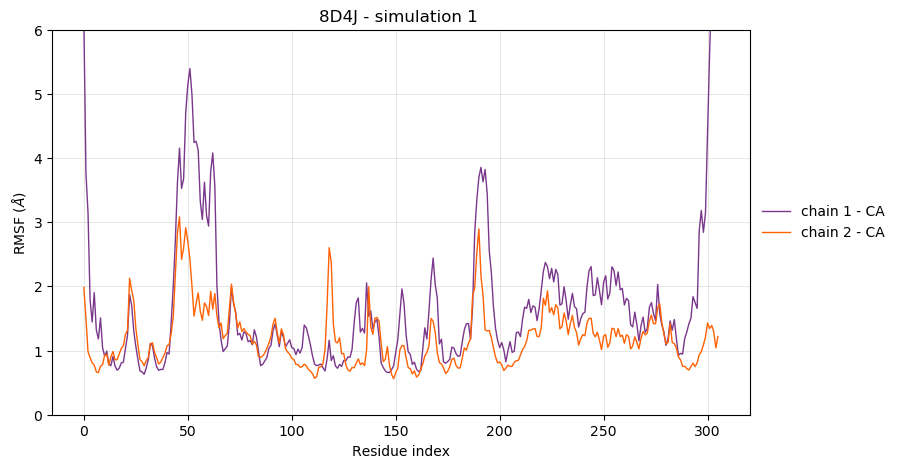

In [138]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_ch1_8_3.rmsf, color = colors2[0], lw = 1, label = 'chain 1 - CA')
plt.plot(rmsf_ch2_8_3.rmsf, color = colors2[1], lw = 1, label = 'chain 2 - CA')

plt.xlabel('Residue index')
plt.ylabel('RMSF ($\AA$)')
plt.title('8D4J - simulation 1 ')

plt.legend(loc="best")
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.grid(color = '#DCDCDC', lw = 0.5)
plt.ylim([0,6])

In [19]:
rmsf_ch1_8_4 = RMSF(ch1_4_eq).run()
rmsf_ch2_8_4 = RMSF(ch2_4_eq).run()

(0, 6)

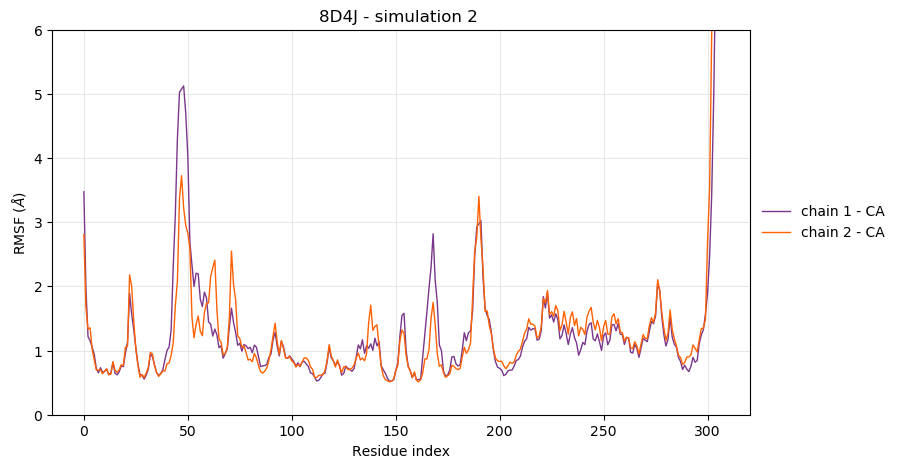

In [141]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_ch1_8_4.rmsf, color = colors2[0], lw = 1, label = 'chain 1 - CA')
plt.plot(rmsf_ch2_8_4.rmsf, color = colors2[1], lw = 1, label = 'chain 2 - CA')

plt.xlabel('Residue index')
plt.ylabel('RMSF ($\AA$)')
plt.title('8D4J - simulation 2 ')

plt.legend(loc="best")
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.grid(color = '#DCDCDC', lw = 0.5)
plt.ylim([0,6])

In [17]:
rmsf_ch1_8_5 = RMSF(ch1_5_eq).run()
rmsf_ch2_8_5 = RMSF(ch2_5_eq).run()

(0, 6)

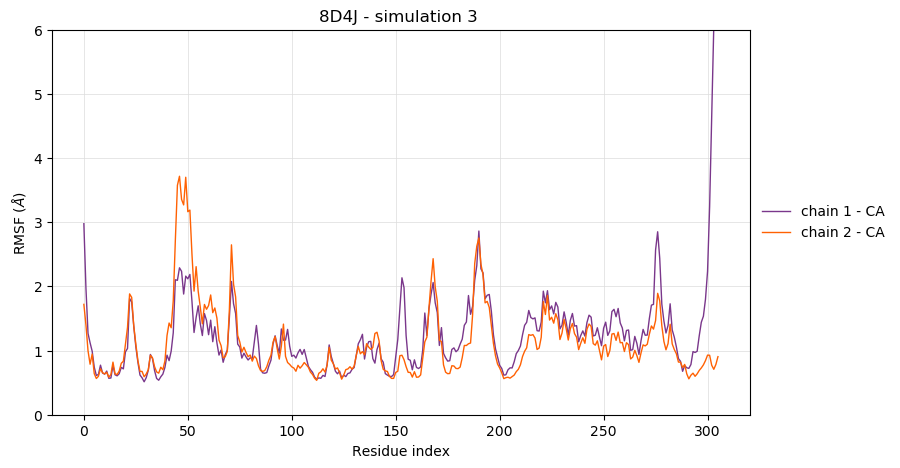

In [139]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_ch1_8_5.rmsf, color = colors2[0], lw = 1, label = 'chain 1 - CA')
plt.plot(rmsf_ch2_8_5.rmsf, color = colors2[1], lw = 1, label = 'chain 2 - CA')

plt.xlabel('Residue index')
plt.ylabel('RMSF ($\AA$)')
plt.title('8D4J - simulation 3 ')

plt.legend(loc="best")
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.grid(color = '#DCDCDC', lw = 0.5)
plt.ylim([0,6])

In [20]:
rmsf_ch1_7 = RMSF(ch1_7vh8_eq).run()
rmsf_ch2_7 = RMSF(ch2_7vh8_eq).run()

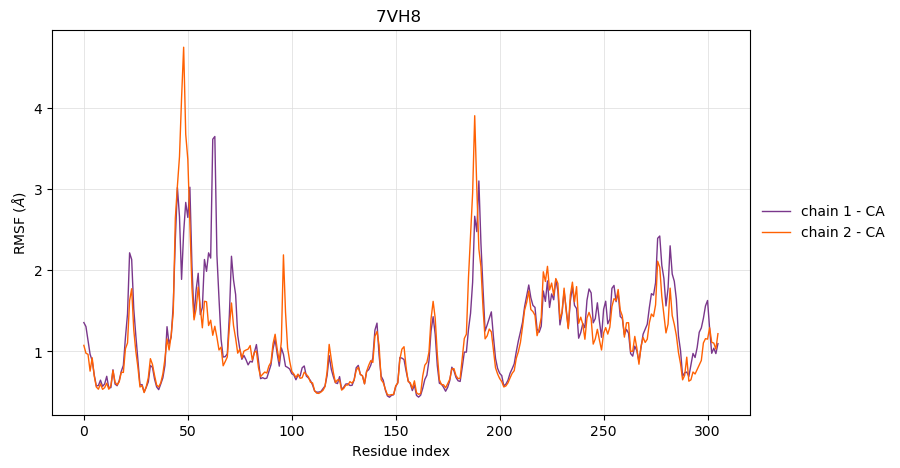

In [140]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_ch1_7.rmsf, color = colors2[0], lw = 1, label = 'chain 1 - CA')
plt.plot(rmsf_ch2_7.rmsf, color = colors2[1], lw = 1, label = 'chain 2 - CA')

plt.xlabel('Residue index')
plt.ylabel('RMSF ($\AA$)')
plt.title('7VH8 ')

plt.legend(loc="best")
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.grid(color = '#DCDCDC', lw = 0.5)


### Combined plots

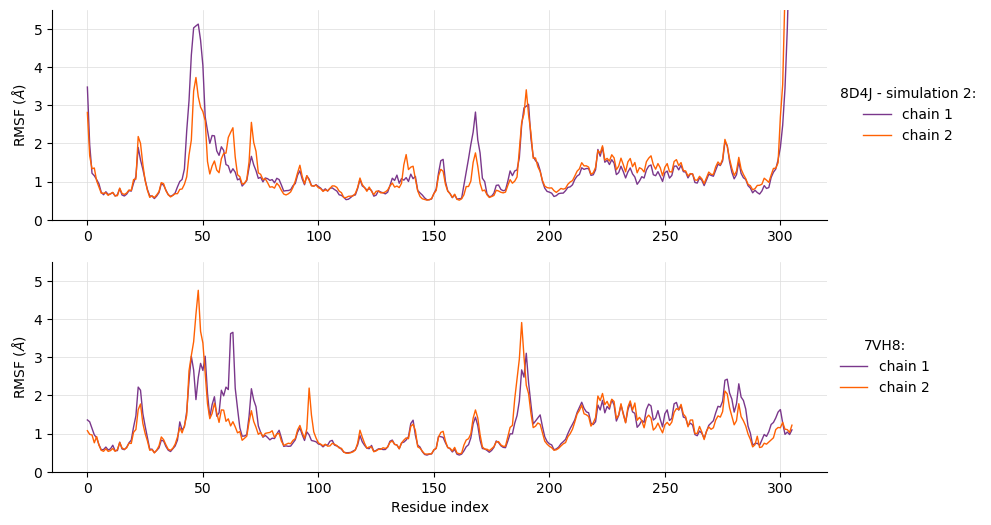

In [21]:
f = plt.figure(figsize=(10,6))
# chian 1 and 2 - 8D4J - sim 2
ax1 = f.add_subplot(211)
ax1.plot(rmsf_ch1_8_4.rmsf, color = colors2[0], lw = 1, label = 'chain 1')
ax1.plot(rmsf_ch2_8_4.rmsf, color = colors2[1], lw = 1, label = 'chain 2')
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5),title="8D4J - simulation 2:")
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSF ($\AA$)")
ax1.set_ylim([0,5.5])

# chain 1 and 2 - 7VH8
ax2 = f.add_subplot(212)
ax2.plot(rmsf_ch1_7.rmsf, color = colors2[0], lw = 1, label = 'chain 1')
ax2.plot(rmsf_ch2_7.rmsf, color = colors2[1], lw = 1, label = 'chain 2')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5), title="7VH8:")
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("Residue index")
ax2.set_ylabel(r"RMSF ($\AA$)")
ax2.set_ylim([0,5.5])

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

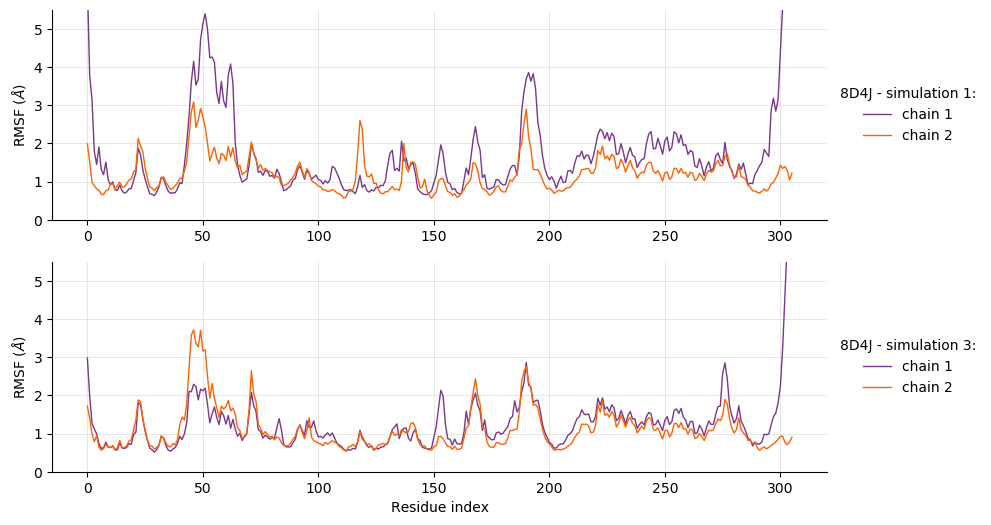

In [22]:
f = plt.figure(figsize=(10,6))
# chian 1 and 2 - 8D4J - sim 2
ax1 = f.add_subplot(211)
ax1.plot(rmsf_ch1_8_3.rmsf, color = colors2[0], lw = 1, label = 'chain 1')
ax1.plot(rmsf_ch2_8_3.rmsf, color = colors2[1], lw = 1, label = 'chain 2')
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5),title="8D4J - simulation 1:")
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSF ($\AA$)")
ax1.set_ylim([0,5.5])

# chain 1 and 2 - 7VH8
ax2 = f.add_subplot(212)
ax2.plot(rmsf_ch1_8_5.rmsf, color = colors2[0], lw = 1, label = 'chain 1')
ax2.plot(rmsf_ch2_8_5.rmsf, color = colors2[1], lw = 1, label = 'chain 2')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5), title="8D4J - simulation 3:")
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("Residue index")
ax2.set_ylabel(r"RMSF ($\AA$)")
ax2.set_ylim([0,5.5])

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

### Comparison between the same chain in different proteins
### I take one of the 8D4J simulation data and compare with WT

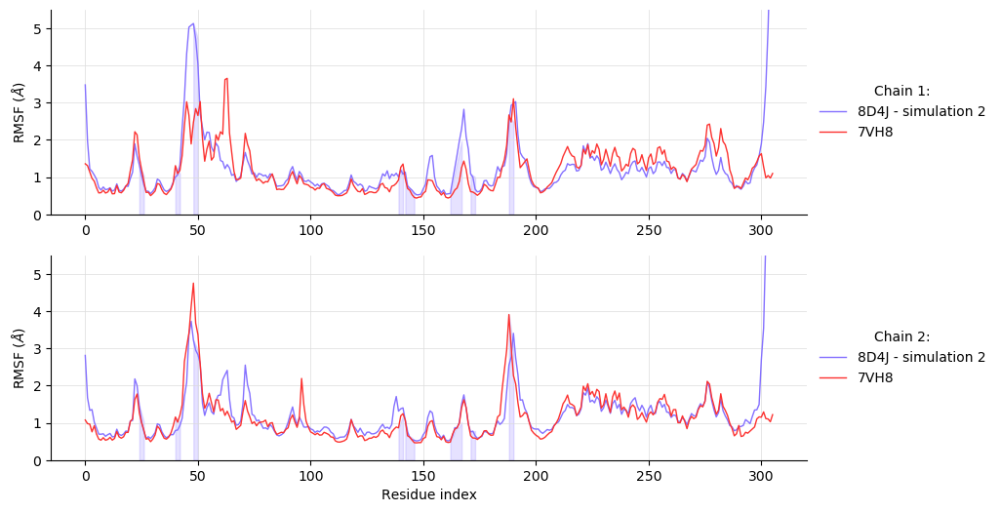

In [118]:
f = plt.figure(figsize=(10,6))
# chian 1
ax1 = f.add_subplot(211)
#ax1.plot(rmsf_ch1_8_3.rmsf, color = colors[0], lw = 1, label = '8D4J - simulation 1')
ax1.plot(rmsf_ch1_8_4.rmsf, color = colors[1], lw = 1, label = '8D4J - simulation 2')
#ax1.plot(rmsf_ch1_8_5.rmsf, color = colors[2], lw = 1, label = '8D4J - simulation 3')
ax1.plot(rmsf_ch1_7.rmsf, color = colors[3], lw = 1, label = '7VH8')
leg = ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5),title="Chain 1:")
leg.get_frame().set_linewidth(0.0)
ax1.grid(color = '#DCDCDC', lw = 0.5)
ax1.set_ylabel(r"RMSF ($\AA$)")
ax1.set_ylim([0,5.5])

# chain 2
ax2 = f.add_subplot(212)
#ax2.plot(rmsf_ch2_8_3.rmsf, color = colors[0], lw = 1, label = '8D4J - simulation 1')
ax2.plot(rmsf_ch2_8_4.rmsf, color = colors[1], lw = 1, label = '8D4J - simulation 2')
#ax2.plot(rmsf_ch2_8_5.rmsf, color = colors[2], lw = 1, label = '8D4J - simulation 3')
ax2.plot(rmsf_ch2_7.rmsf, color = colors[3], lw = 1, label = '7VH8')
leg = ax2.legend(loc='center left', bbox_to_anchor=(1, 0.5), title="Chain 2:")
ax2.grid(color = '#DCDCDC', lw = 0.5)
leg.get_frame().set_linewidth(0.0)
ax2.set_xlabel("Residue index")
ax2.set_ylabel(r"RMSF ($\AA$)")
ax2.set_ylim([0,5.5])

ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

ax1.fill_between(np.linspace(24,26,2), rmsf_ch1_8_4.rmsf[24:26], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(40,42,2), rmsf_ch1_7.rmsf[40:42], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(48,50,2), rmsf_ch1_8_4.rmsf[48:50], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(139,141,2), rmsf_ch1_7.rmsf[139:141], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(142,146,4), rmsf_ch1_7.rmsf[142:146], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(162,167,5), rmsf_ch1_8_4.rmsf[162:167], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(171,173,2), rmsf_ch1_8_4.rmsf[171:173], color = colors[1], alpha = 0.2)
ax1.fill_between(np.linspace(188,190,2), rmsf_ch1_7.rmsf[188:190], color = colors[1], alpha = 0.2)


ax2.fill_between(np.linspace(24,26,2), rmsf_ch2_8_4.rmsf[24:26], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(40,42,2), rmsf_ch2_7.rmsf[40:42], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(48,50,2), rmsf_ch2_8_4.rmsf[48:50], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(139,141,2), rmsf_ch2_7.rmsf[139:141], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(142,146,4), rmsf_ch2_7.rmsf[142:146], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(162,167,5), rmsf_ch2_8_4.rmsf[162:167], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(171,173,2), rmsf_ch2_8_4.rmsf[171:173], color = colors[1], alpha = 0.2)
ax2.fill_between(np.linspace(188,190,2), rmsf_ch2_7.rmsf[188:190], color = colors[1], alpha = 0.2)

### Active site - all atoms

In [122]:
new_cmap = ['#A6CEE3','#1F78B4','#B2DF8A','#33A02C','#FB9A99','#E31A1C','#FDBF6F','#FF7F00','#CAB2D6','#6A3D9A','#ECEC28','#B15928']
rtg_r = LinearSegmentedColormap.from_list("rtg", new_cmap)
colors = rtg_r(np.linspace(0,1,12))

In [59]:
# ---------------------- 8D4J ------------------------------

AS_sel = """resid 25 or resid 41 or resid 49 
or resid 140 or resid 143 or resid 144 or resid 145
or resid 163 or resid 165 or resid 166 
or resid 172 or resid 189"""

AS_terminus = "resnum 1"

or_bool = " or "

#active sites 
# 8D4J - 1
ch1_3_AS =  chain1_8d4j_3_eq.select_atoms(AS_sel+or_bool+AS_terminus)
ch2_3_AS =  chain2_8d4j_3_eq.select_atoms(AS_sel+or_bool+AS_terminus)
print("chain1 - AS: ", ch1_3_AS.n_residues)
print("chain2 - AS: ", ch2_3_AS.n_residues)

# 8D4J - 2
ch1_4_AS =  chain1_8d4j_4_eq.select_atoms(AS_sel+or_bool+AS_terminus)
ch2_4_AS =  chain2_8d4j_4_eq.select_atoms(AS_sel+or_bool+AS_terminus)
print("chain1 - AS: ", ch1_4_AS.n_residues)
print("chain2 - AS: ", ch2_4_AS.n_residues)

# 8D4J - 3
ch1_5_AS =  chain1_8d4j_5_eq.select_atoms(AS_sel+or_bool+AS_terminus)
ch2_5_AS =  chain2_8d4j_5_eq.select_atoms(AS_sel+or_bool+AS_terminus)
print("chain1 - AS: ", ch1_5_AS.n_residues)
print("chain2 - AS: ", ch2_5_AS.n_residues)


# ---------------------- 7VH8 ------------------------------
print()
AS_sel = """resid 25 or resid 41 or resid 49 
or resid 140 or resid 143 or resid 144 or resid 145
or resid 163 or resid 165 or resid 166 
or resid 172 or resid 189"""

AS_sel_2 = """resnum 331 or resnum 347 or resnum 355 
or resnum 446 or resnum 449 or resnum 450 or resnum 451
or resnum 469 or resnum 471 or resnum 472 
or resnum 478 or resnum 495"""

AS_terminus_2 = "resnum 307"

AS_terminus = "resnum 1"

or_bool = " or "

#active sites
ch1_7vh8_AS = chain1_7vh8_eq.select_atoms(AS_sel+or_bool+AS_terminus)
ch2_7vh8_AS = chain2_7vh8_eq.select_atoms(AS_sel_2+or_bool+AS_terminus_2)
print("chain1 - AS: ", ch1_AS.n_residues)
print("chain2 - AS: ", ch2_AS.n_residues)

chain1 - AS:  13
chain2 - AS:  13
chain1 - AS:  13
chain2 - AS:  13
chain1 - AS:  13
chain2 - AS:  13

chain1 - AS:  13
chain2 - AS:  13


In [60]:
rmsf_as1_8_3 = RMSF(ch1_3_AS).run()
rmsf_as2_8_3 = RMSF(ch2_3_AS).run()

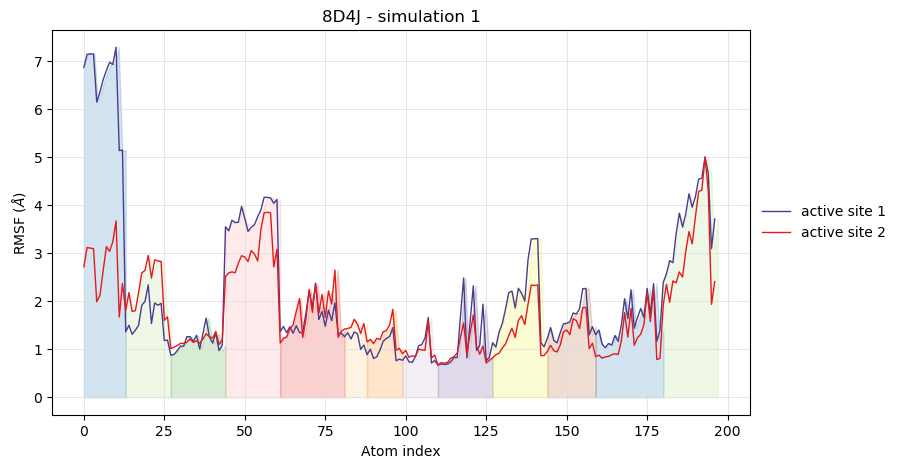

In [133]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_as1_8_3.rmsf, color = colors2[2], lw = 1, label = 'active site 1')
plt.plot(rmsf_as2_8_3.rmsf, color = colors2[3], lw = 1, label = 'active site 2')
plt.xlabel('Atom index')
plt.ylabel('RMSF ($\AA$)')
plt.title('8D4J - simulation 1')
plt.legend(loc="best")
plt.grid(color = '#DCDCDC', lw = 0.5)
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.fill_between(np.linspace(0,13,13), rmsf_as1_8_3.rmsf[0:13], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(13,27,14), rmsf_as2_8_3.rmsf[13:27], color = colors[2], alpha = 0.2)
plt.fill_between(np.linspace(27,44,17), rmsf_as1_8_3.rmsf[27:44], color = colors[3], alpha = 0.2)
plt.fill_between(np.linspace(44,61,17), rmsf_as1_8_3.rmsf[44:61], color = colors[4], alpha = 0.2)
plt.fill_between(np.linspace(61,81,20), rmsf_as2_8_3.rmsf[61:81], color = colors[5], alpha = 0.2)
plt.fill_between(np.linspace(81,88,7), rmsf_as2_8_3.rmsf[81:88], color = colors[6], alpha = 0.2)
plt.fill_between(np.linspace(88,99,11), rmsf_as2_8_3.rmsf[88:99], color = colors[7], alpha = 0.2)
plt.fill_between(np.linspace(99,110,11), rmsf_as1_8_3.rmsf[99:110], color = colors[8], alpha = 0.2)
plt.fill_between(np.linspace(110,127,17), rmsf_as1_8_3.rmsf[110:127], color = colors[9], alpha = 0.2)
plt.fill_between(np.linspace(127,144,17), rmsf_as1_8_3.rmsf[127:144], color = colors[10], alpha = 0.2)
plt.fill_between(np.linspace(144,159,15), rmsf_as1_8_3.rmsf[144:159], color = colors[11], alpha = 0.2)
plt.fill_between(np.linspace(159,180,21), rmsf_as1_8_3.rmsf[159:180], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(180,197,17), rmsf_as1_8_3.rmsf[180:197], color = colors[2], alpha = 0.2)

In [66]:
rmsf_as1_8_4 = RMSF(ch1_4_AS).run()
rmsf_as2_8_4 = RMSF(ch2_4_AS).run()

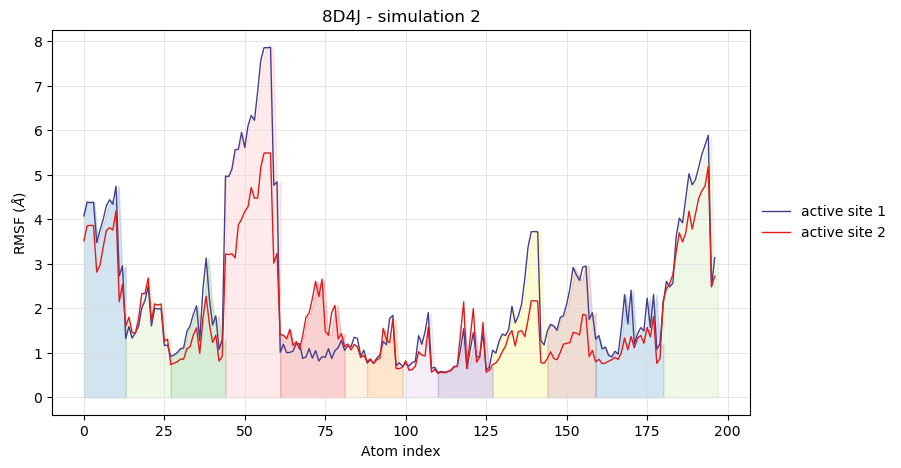

In [134]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_as1_8_4.rmsf, color = colors2[2], lw = 1, label = 'active site 1')
plt.plot(rmsf_as2_8_4.rmsf, color = colors2[3], lw = 1, label = 'active site 2')
plt.xlabel('Atom index')
plt.ylabel('RMSF ($\AA$)')
plt.title('8D4J - simulation 2')
plt.legend(loc="best")
plt.grid(color = '#DCDCDC', lw = 0.5)
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.fill_between(np.linspace(0,13,13), rmsf_as1_8_4.rmsf[0:13], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(13,27,14), rmsf_as2_8_4.rmsf[13:27], color = colors[2], alpha = 0.2)
plt.fill_between(np.linspace(27,44,17), rmsf_as1_8_4.rmsf[27:44], color = colors[3], alpha = 0.2)
plt.fill_between(np.linspace(44,61,17), rmsf_as1_8_4.rmsf[44:61], color = colors[4], alpha = 0.2)
plt.fill_between(np.linspace(61,81,20), rmsf_as2_8_4.rmsf[61:81], color = colors[5], alpha = 0.2)
plt.fill_between(np.linspace(81,88,7), rmsf_as2_8_4.rmsf[81:88], color = colors[6], alpha = 0.2)
plt.fill_between(np.linspace(88,99,11), rmsf_as2_8_4.rmsf[88:99], color = colors[7], alpha = 0.2)
plt.fill_between(np.linspace(99,110,11), rmsf_as1_8_4.rmsf[99:110], color = colors[8], alpha = 0.2)
plt.fill_between(np.linspace(110,127,17), rmsf_as1_8_4.rmsf[110:127], color = colors[9], alpha = 0.2)
plt.fill_between(np.linspace(127,144,17), rmsf_as1_8_4.rmsf[127:144], color = colors[10], alpha = 0.2)
plt.fill_between(np.linspace(144,159,15), rmsf_as1_8_4.rmsf[144:159], color = colors[11], alpha = 0.2)
plt.fill_between(np.linspace(159,180,21), rmsf_as1_8_4.rmsf[159:180], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(180,197,17), rmsf_as1_8_4.rmsf[180:197], color = colors[2], alpha = 0.2)

In [69]:
rmsf_as1_8_5 = RMSF(ch1_5_AS).run()
rmsf_as2_8_5 = RMSF(ch2_5_AS).run()

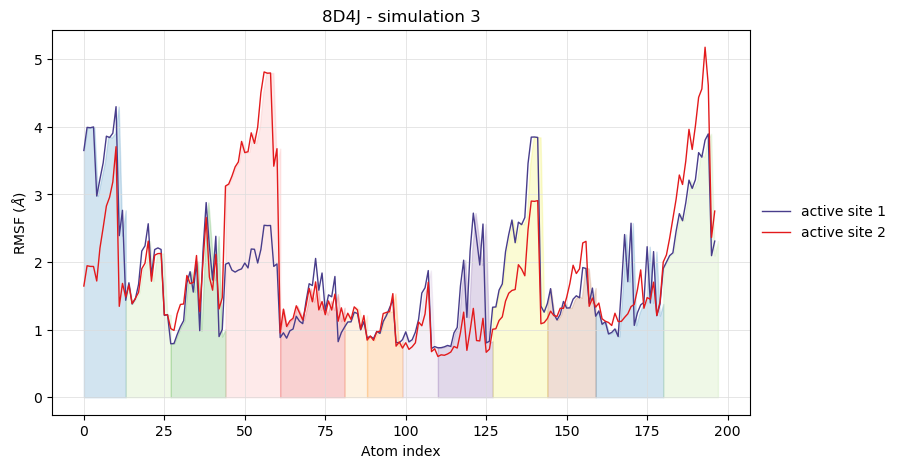

In [135]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_as1_8_5.rmsf, color = colors2[2], lw = 1, label = 'active site 1')
plt.plot(rmsf_as2_8_5.rmsf, color = colors2[3], lw = 1, label = 'active site 2')
plt.xlabel('Atom index')
plt.ylabel('RMSF ($\AA$)')
plt.title('8D4J - simulation 3')
plt.legend(loc="best")
plt.grid(color = '#DCDCDC', lw = 0.5)
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.fill_between(np.linspace(0,13,13), rmsf_as1_8_5.rmsf[0:13], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(13,27,14), rmsf_as2_8_5.rmsf[13:27], color = colors[2], alpha = 0.2)
plt.fill_between(np.linspace(27,44,17), rmsf_as1_8_5.rmsf[27:44], color = colors[3], alpha = 0.2)
plt.fill_between(np.linspace(44,61,17), rmsf_as2_8_5.rmsf[44:61], color = colors[4], alpha = 0.2)
plt.fill_between(np.linspace(61,81,20), rmsf_as2_8_5.rmsf[61:81], color = colors[5], alpha = 0.2)
plt.fill_between(np.linspace(81,88,7), rmsf_as2_8_5.rmsf[81:88], color = colors[6], alpha = 0.2)
plt.fill_between(np.linspace(88,99,11), rmsf_as2_8_5.rmsf[88:99], color = colors[7], alpha = 0.2)
plt.fill_between(np.linspace(99,110,11), rmsf_as1_8_5.rmsf[99:110], color = colors[8], alpha = 0.2)
plt.fill_between(np.linspace(110,127,17), rmsf_as1_8_5.rmsf[110:127], color = colors[9], alpha = 0.2)
plt.fill_between(np.linspace(127,144,17), rmsf_as1_8_5.rmsf[127:144], color = colors[10], alpha = 0.2)
plt.fill_between(np.linspace(144,159,15), rmsf_as1_8_5.rmsf[144:159], color = colors[11], alpha = 0.2)
plt.fill_between(np.linspace(159,180,21), rmsf_as1_8_5.rmsf[159:180], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(180,197,17), rmsf_as1_8_5.rmsf[180:197], color = colors[2], alpha = 0.2)

In [71]:
rmsf_as1_7 = RMSF(ch1_7vh8_AS).run()
rmsf_as2_7 = RMSF(ch2_7vh8_AS).run()

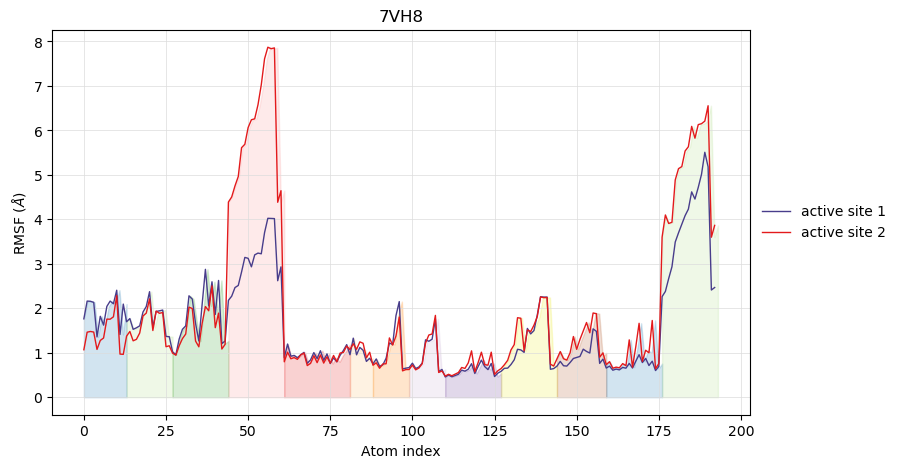

In [136]:
plt.figure(figsize = (9,5))
plt.plot(rmsf_as1_7.rmsf, color = colors2[2], lw = 1, label = 'active site 1')
plt.plot(rmsf_as2_7.rmsf, color = colors2[3], lw = 1, label = 'active site 2')
plt.xlabel('Atom index')
plt.ylabel('RMSF ($\AA$)')
plt.title('7VH8')
plt.legend(loc="best")
plt.grid(color = '#DCDCDC', lw = 0.5)
leg = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
leg.get_frame().set_linewidth(0.0)

plt.fill_between(np.linspace(0,13,13), rmsf_as1_7.rmsf[0:13], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(13,27,14), rmsf_as1_7.rmsf[13:27], color = colors[2], alpha = 0.2)
plt.fill_between(np.linspace(27,44,17), rmsf_as1_7.rmsf[27:44], color = colors[3], alpha = 0.2)
plt.fill_between(np.linspace(44,61,17), rmsf_as2_7.rmsf[44:61], color = colors[4], alpha = 0.2)
plt.fill_between(np.linspace(61,81,20), rmsf_as1_7.rmsf[61:81], color = colors[5], alpha = 0.2)
plt.fill_between(np.linspace(81,88,7), rmsf_as1_7.rmsf[81:88], color = colors[6], alpha = 0.2)
plt.fill_between(np.linspace(88,99,11), rmsf_as1_7.rmsf[88:99], color = colors[7], alpha = 0.2)
plt.fill_between(np.linspace(99,110,11), rmsf_as1_7.rmsf[99:110], color = colors[8], alpha = 0.2)
plt.fill_between(np.linspace(110,127,17), rmsf_as1_7.rmsf[110:127], color = colors[9], alpha = 0.2)
plt.fill_between(np.linspace(127,144,17), rmsf_as2_7.rmsf[127:144], color = colors[10], alpha = 0.2)
plt.fill_between(np.linspace(144,159,15), rmsf_as2_7.rmsf[144:159], color = colors[11], alpha = 0.2)
plt.fill_between(np.linspace(159,176,17), rmsf_as2_7.rmsf[159:176], color = colors[1], alpha = 0.2)
plt.fill_between(np.linspace(176,193,17), rmsf_as2_7.rmsf[176:193], color = colors[2], alpha = 0.2)